# **Did Sombody Say Corgi?**

You're as much a passionate corgi lover as I am? Then you've come to the right place! ;)

Please skip to the **Testing** section if just you came to play around with the pretrained model!

## **Training**

Let's see which GPU type Coogle assigned to us... Anything different then a Tesla V100 is sadly a waste of time. Because of this, and also because of memory constraints with standard Colab, you will probably need to get yourself one month of Colab Pro.



In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Wed Dec 30 13:15:55 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    24W / 300W |      0MiB / 16130MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Next let's clone the StyleGAN2-ADA repository. Big thanks to [RoyWheels](https://github.com/RoyWheels/stylegan2-ada) for his raw image loading fork!

In [ ]:
!git clone https://github.com/RoyWheels/stylegan2-ada.git
%cd stylegan2-ada

Cloning into 'stylegan2-ada'...
remote: Enumerating objects: 163, done.
remote: Total 163 (delta 0), reused 0 (delta 0), pack-reused 163
Receiving objects: 100% (163/163), 1.34 MiB | 2.89 MiB/s, done.
Resolving deltas: 100% (83/83), done.
/content/stylegan2-ada
TensorFlow 1.x selected.


Next mount the Google Drive in order to resume from the last model checkpoint.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Download my corgi dataset using *gdown*.

In [ ]:
!gdown https://drive.google.com/u/0/uc?id=1WDLf-fhamq0gl3RsAdx4twDyilpW-Mq9&export=download

Downloading...
From: https://drive.google.com/u/0/uc?id=1WDLf-fhamq0gl3RsAdx4twDyilpW-Mq9
To: /content/stylegan2-ada/crop1024.zip
18.7GB [03:36, 86.3MB/s]


Unzip.

In [ ]:
!mkdir corgis
!unzip crop1024.zip -d corgis
!rm crop1024.zip

Streaming output truncated to the last 5000 lines.
  inflating: corgis/CEVgCDlJd0f.jpeg  
  inflating: corgis/CEVGGDtJ5uS.jpeg  
  inflating: corgis/CEVGGrUlMsv.jpeg  
  inflating: corgis/CEVGGWEpFyI.jpeg  
  inflating: corgis/CEVghYqJnEx.jpeg  
  inflating: corgis/CEvGiBFJOVH.jpeg  
  inflating: corgis/CEvGlcDACLM.jpeg  
  inflating: corgis/CEVGLOwJPvG.jpeg  
  inflating: corgis/CEvgOKhoiA3.jpeg  
  inflating: corgis/CEVgq3VD9Ur.jpeg  
  inflating: corgis/CEvGs43pGn8.jpeg  
  inflating: corgis/CEvGS51MNzw.jpeg  
  inflating: corgis/CEvgSYppTWT.jpeg  
  inflating: corgis/CEvgtCgJBGg.jpeg  
  inflating: corgis/CEVGVEUJvWH.jpeg  
  inflating: corgis/CEVgvWpBBek.jpeg  
  inflating: corgis/CEvGwrmJXTX.jpeg  
  inflating: corgis/CEVGXnDJ0qZ.jpeg  
  inflating: corgis/CEvgyoYJCZW.jpeg  
  inflating: corgis/CEVH0XYpoui.jpeg  
  inflating: corgis/CEVh5Ympdmr.jpeg  
  inflating: corgis/CEVH6jXJNUE.jpeg  
  inflating: corgis/CEVhCKapX4Y.jpeg  
  inflating: corgis/CEVHEFWpSPN.jpeg  
  inflating: 

Create a raw image dataset.

In [ ]:
!mkdir datasets
!python dataset_tool.py create_from_images_raw datasets/corgis /content/stylegan2-ada/corgis

Loading images from "/content/stylegan2-ada/corgis"
detected 136255 images ...
Shuffle the images...
Creating dataset "datasets/corgis"
Adding the images to tfrecords ...
added images 0
added images 1000
added images 2000
added images 3000
added images 4000
added images 5000
added images 6000
added images 7000
added images 8000
added images 9000
added images 10000
added images 11000
added images 12000
added images 13000
added images 14000
added images 15000
added images 16000
added images 17000
added images 18000
added images 19000
added images 20000
added images 21000
added images 22000
added images 23000
added images 24000
added images 25000
added images 26000
added images 27000
added images 28000
added images 29000
added images 30000
added images 31000
added images 32000
added images 33000
added images 34000
added images 35000
added images 36000
added images 37000
added images 38000
added images 39000
added images 40000
added images 41000
added images 42000
added images 43000
added 

Continue training. If you want to train a fresh model just drop the *--resume latest* argument.

In [ ]:
%tensorflow_version 1.x
!python train.py --outdir=/content/drive/My\ Drive/models/stylegan2-corgis/ \
    --data=datasets/corgis \
    --gpus=1 --mirror=1 --cfg=v100_16gb --aug=ada --snap=10 --metrics=none \
    --res_log2 8 --min_w 4 --min_h 4 --resume latest

## **Testing**

Here you can put the pre-trained StyleGAN2 corgi model into action! :) I'm quite certain you'll have a good time.

In [ ]:
# Uncomment if you mirrored the model into your Google Drive
#from google.colab import drive
#drive.mount('/content/drive')

*ipyplot* is a nice little library to plot image grids from PIL image lists.

In [2]:
!pip install ipyplot

In [3]:
!git clone https://github.com/RoyWheels/stylegan2-ada.git
%cd stylegan2-ada
%tensorflow_version 1.x

fatal: destination path 'stylegan2-ada' already exists and is not an empty directory.
/content/stylegan2-ada
TensorFlow 1.x selected.


Set the model snapshot you want to use here. Either use one from your mounted Google Drive or download the latest model using *gdown*.

In [4]:
#network_pkl='/content/drive/My Drive/models/stylegan2-corgis/00018-corgis-mirror-v100_16gb-ada-resumelatest/network-snapshot-005080.pkl'

!gdown https://drive.google.com/u/0/uc?id=1-qWgnbcU92nWTS-Bp-MRjRjJqGJck3Ou&export=download
network_pkl = 'network-snapshot-005080.pkl'

Downloading...
From: https://drive.google.com/u/0/uc?id=1-qWgnbcU92nWTS-Bp-MRjRjJqGJck3Ou
To: /content/stylegan2-ada/network-snapshot-005080.pkl
382MB [00:02, 158MB/s]


In [5]:
import os
import pickle
import re

import numpy as np
import PIL.Image

import dnnlib
import dnnlib.tflib as tflib

tflib.init_tf()
print('Loading networks from "%s"...' % network_pkl)
with dnnlib.util.open_url(network_pkl) as fp:
    _G, _D, Gs = pickle.load(fp)

def generate_image(z, truncation_psi=None, noise=None):
    """Generates a StyleGAN2 output based on a latent vector.
    - truncation_psi let's you control how much artistic freedom you'd like to give the model
        small, i.e. 0.1-0.3: gives you nice corgis, but not too exciting overall
        high, i.e. 0.8-1.0: Some corgis might look like they have a gene defect, but much more exciting results in general.
    - noise let's you provide fixed noice
    """
    Gs_kwargs = {
        'output_transform': dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True),
        'randomize_noise': False
    }
    if truncation_psi is not None:
        Gs_kwargs['truncation_psi'] = truncation_psi

    noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]
    label = np.zeros([1] + Gs.input_shapes[1][1:])

    if noise is None:
        noise = {var: np.random.randn(*var.shape.as_list()) for var in noise_vars}
    tflib.set_vars(noise) # [height, width]

    #if w_space:
    #    images = Gs.components.synthesis.run(z, **Gs_kwargs)
    #else:
    images = Gs.run(z, label, **Gs_kwargs) # [minibatch, height, width, channel]
    pil_image = PIL.Image.fromarray(images[0], 'RGB')

    return pil_image

def random_z(seed=None):
    """Create a random latent vector"""
    if seed is None:
        z = np.random.randn(1, *Gs.input_shape[1:])
    else:
        rnd = np.random.RandomState(seed)
        z = rnd.randn(1, *Gs.input_shape[1:])
    return z

def random_noise():
    """Create random noise"""
    noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]
    return {var: np.random.randn(*var.shape.as_list()) for var in noise_vars}

def map_z(z):
    """Map z into w space"""
    return Gs.components.mapping.run(z, None)

def interpolate(z1, z2, steps):
    """Interpolate between two latent vectors"""
    w1 = map_z(z1)
    w2 = map_z(z2)

    z_latents = np.vstack([(1 - i) * z1 + i * z2 for i in np.linspace(0, 1, steps)])
    w_latents = np.vstack([(1 - i) * w1 + i * w2 for i in np.linspace(0, 1, steps)])

    return z_latents, w_latents

Loading networks from "network-snapshot-005080.pkl"...


### Create Image Samples

Lower the *truncation_psi* parameter for more sophisicated (but also more boring) corgi images. 

**Warning:** Setting it to *1.0* might produce mildly disturbing outputs though :D 

100%|██████████| 100/100 [00:13<00:00,  7.24it/s]



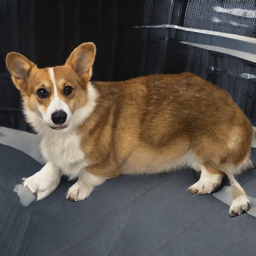
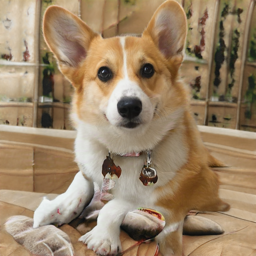
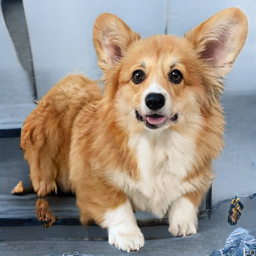
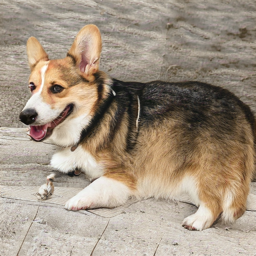
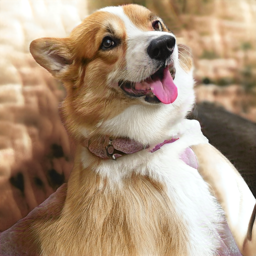
...
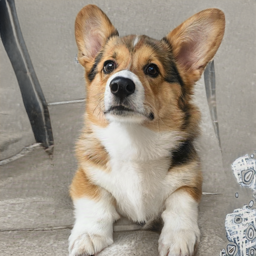
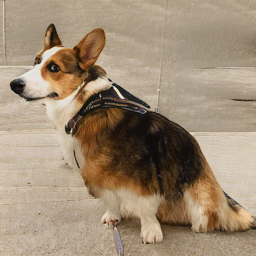
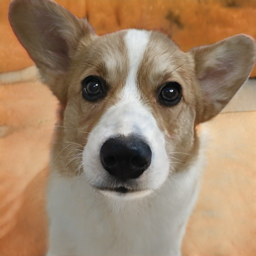
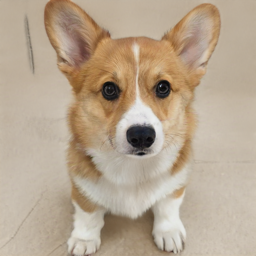
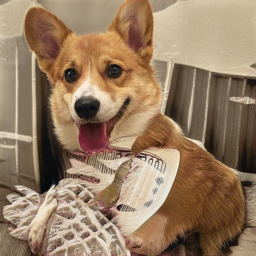

In [11]:
from tqdm import tqdm
import ipyplot

truncation_psi=0.8

images = []
for i in tqdm(range(30)):
    z = random_z()
    noise = random_noise()
    images.append(generate_image(z, truncation_psi=truncation_psi, noise=noise))

ipyplot.plot_images(images, img_width=256)

### Create Videos

Needed for video creation.

In [ ]:
!sudo apt-get install ffmpeg x264 libx264-dev

Reading package lists... Done
Building dependency tree       
Reading state information... Done
ffmpeg is already the newest version (7:3.4.8-0ubuntu0.2).
The following additional packages will be installed:
  libffms2-4 libgpac4
The following NEW packages will be installed:
  libffms2-4 libgpac4 libx264-dev x264
0 upgraded, 4 newly installed, 0 to remove and 29 not upgraded.
Need to get 2,123 kB of archives.
After this operation, 6,395 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libffms2-4 amd64 2.23-2 [57.3 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic-updates/universe amd64 libgpac4 amd64 0.5.2-426-gc5ad4e4+dfsg5-3ubuntu0.1 [1,526 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libx264-dev amd64 2:0.152.2854+gite9a5903-2 [461 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic/universe amd64 x264 amd64 2:0.152.2854+gite9a5903-2 [78.5 kB]
Fetched 2,123 kB in 0s (14.0 MB/s)
debconf: unable to initialize fron

Method to create a video from a list of PIL images. In it's current configuration your browser will be able to display it.

In [ ]:
import random
import cv2

def save_video(images, fps, filename, size=(1024, 1024)):
    #fourcc = cv2.VideoWriter_fourcc(*'H264')
    #fourcc = cv2.VideoWriter_fourcc('V','P','8','0')
    #fourcc = cv2.VideoWriter_fourcc(*'vp80')
    fourcc = cv2.VideoWriter_fourcc(*'MP4V')
    #fourcc = 0x00000021
    out = cv2.VideoWriter(f'{filename}.mp4', fourcc, fps, size)
    for img in images:
        img = img.resize(size)
        out.write(cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR))
    out.release()

    os.system(f'rm {filename}_.mp4')
    os.system(f'ffmpeg -i {filename}.mp4 -vcodec libx264 {filename}_.mp4')

#### Random Interpolation Walk

My experiments showed that random walks in the latent space don't produce nice results. That's why I choose to interpolate between independently sampled latent vectors instead.



In [ ]:
from tqdm import tqdm

# Synthesis options
support_doggos = 5
steps_between_doggos = 70
noise_denominator = 100
fix_noise = True    # Fixed noise is recommended for video synthesis
truncation_psi = 0.5

# Video output options
size = (1024, 1024)
filename = 'doggo_interpolation'
fps = 15

def corgi_interpolation_random():
    """Interpolate between randomly sampled corgis"""
    z = random_z()
    if fix_noise:
        noise = random_noise()

    images = []
    for d in range(support_doggos):
        z_ = random_z()

        # Linear interpolation
        z_step = (z_ - z) / steps_between_doggos
        for i in tqdm(range(steps_between_doggos + 1)):
            if not fix_noise:
                noise = random_noise()
                noise = {k: noise[k] / noise_denominator + noise[k] for k in noise.keys()}
            images.append(generate_image(z, truncation_psi=truncation_psi, noise=noise))
            z += z_step

    save_video(images, fps, filename, size=size)

In [ ]:
from IPython.core.display import Video
corgi_interpolation_random()
Video("doggo_interpolation_.mp4", embed=True)

100%|██████████| 71/71 [00:02<00:00, 32.25it/s]


#### Planned Interpolation Walk

In [ ]:
# Synthesis options
support_doggos = 5
steps_between_doggos = 50
noise_denominator = 100
fix_noise = True    # Fixed noise is recommended for video synthesis
truncation_psi = 0.5

# Video output options
size = (1024, 1024)
filename = 'doggo_interpolation'
fps = 15

def corgi_interpolation(z_list):
    """Interpolate between preselected list of latent corgi space vectors"""
    z = z_list[0]

    if fix_noise:
        noise = random_noise()

    images = []
    for d in range(1, len(z_list)):
        z_ = z_list[d]

        # Linear interpolation
        z_step = (z_ - z) / steps_between_doggos
        for i in tqdm(range(steps_between_doggos + 1)):
            if not fix_noise:
                noise = random_noise()
                noise = {k: noise[k] / noise_denominator + noise[k] for k in noise.keys()}
            images.append(generate_image(z, truncation_psi=truncation_psi, noise=noise))
            z += z_step

    save_video(images, fps, filename, size=size)

Plot some corgis to select from.

100%|██████████| 24/24 [00:03<00:00,  6.13it/s]



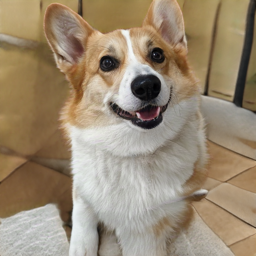
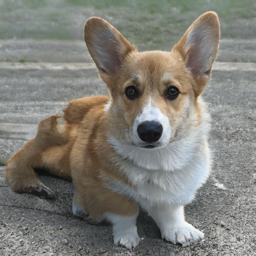
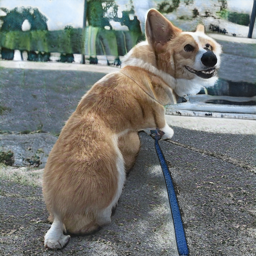
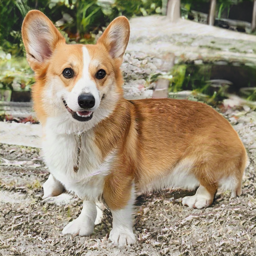
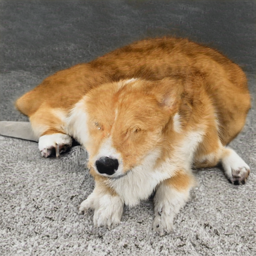
...
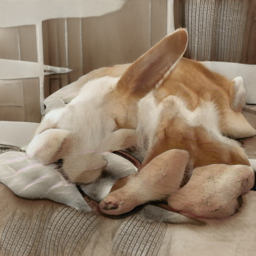
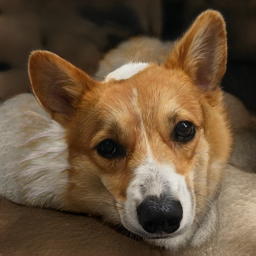
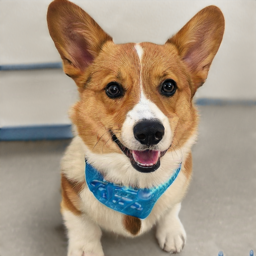
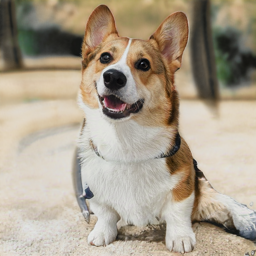
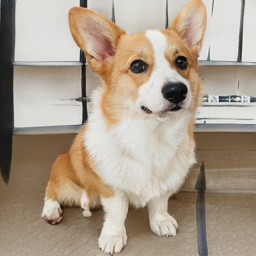

In [ ]:
images = []
z_list = []
truncation_psi = 0.7
for i in tqdm(range(25)):
    z = random_z()
    noise = random_noise()
    images.append(generate_image(z, truncation_psi=truncation_psi, noise=noise))
    z_list.append(z)

ipyplot.plot_images(images, img_width=256)

Put the image ids of corgis you like the most into the *nice_corgis_idx* list.

In [ ]:
nice_corgis_idx = [14, 12, 18, 16, 21, 23, 22, 5, 7]
z_list_selected = [z_list[i] for i in nice_corgis_idx]
from IPython.core.display import Video
corgi_interpolation(z_list_selected)
Video("doggo_interpolation_.mp4", embed=True)

100%|██████████| 51/51 [00:03<00:00, 16.38it/s]
